<a href="https://colab.research.google.com/github/Luciahelenasantos/Deep_Learning/blob/main/SPRINTII0307.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ***1. Importando as bibliotecas necessárias para executar o notebook***

In [ ]:
import pandas as pd
import numpy as np
import os
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg # para uso de imagens
import sklearn.metrics as skm
import itertools
from google.colab import drive # acesso ao drive do google Colab - 'drive.mount'
from sklearn.model_selection import train_test_split # para divisão de treino e teste
from keras import models
from keras import layers
from keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import confusion_matrix, classification_report
from datetime import datetime
from tensorflow import keras

# ***2. Funções necessárias para executar o notebook***

In [ ]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    Esta função imprime e plota a matriz de confusão.
    A normalização pode ser aplicada definindo `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Matriz de confusão normalizada")
    else:
        print('Matriz de confusão sem normalização')

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=360)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('Label real')
    plt.xlabel('Label predito')

In [ ]:
# Função que cria a variável "class" com valores categóricos

def calcula_classe_fire(fire):
  vfire = fire

  if fire == 0:
    return "Sem fogo"
  elif fire == 1:
    return "Com fogo"

# ***3. Acessando e tratando os dados que serão a entrada do modelo de deep learning***

In [ ]:
# Apontando para My Drive

drive.mount('/content/drive', force_remount=True)
os.chdir('/content/drive/My Drive/')

Mounted at /content/drive


In [ ]:
# Acessando o diretório das imagens

r = 'datafire/working/train_images/train/'
print(os.listdir(r))

['img_713_jpg.rf.1a24d8919fdbea0220b214a1cf149be4.jpg', 'ck0txbqlewjuv0721agjyhu78_jpeg_jpg.rf.477a64a2b57a60ff8e5beb9fccce0570.jpg', 'ck0u98ba1xzpe0721rgjjjun5_jpeg_jpg.rf.82f6386c331dc11b673b3059c9cb3866.jpg', 'ck0t7o8ovlpsl0794ci1p3k3a_jpeg_jpg.rf.1e209057b42eec805af739a09f0a39f4.jpg', 'ck0kkxngib3qh0721x6mgyttk_jpeg_jpg.rf.0f834e84f77bdca42a343bb7ae13dff1.jpg', 'ck0t59c0wnw4607010uyziiam_jpeg_jpg.rf.607aedadbb2f81b3035bf34b80e7225f.jpg', 'ck0ndrnhi3fkn0794vbn53c08_jpeg_jpg.rf.c91e9636d9c0760ef91ca355e8371abd.jpg', 'ck0oukbtwsjxp083897f03qo4_jpeg_jpg.rf.cbd3b1ff21a7a080b858e58cf3dd73b5.jpg', '77_jpg.rf.2bc80c2e6a73b1fc604b4aa49179152e.jpg', 'ck0twkzggsrnb0838b6na9joz_jpeg_jpg.rf.726538856df9402931a7c23c8393c75e.jpg', 'img_357_jpg.rf.225884a6410189793ecff81a83d99052.jpg', '347_jpg.rf.a0915a96ba6d3d41244545dceca7d20e.jpg', 'ck0l9d0tt981g0863dmttkl8h_jpeg_jpg.rf.9283ca14e33c6155250be7f29445d7b1.jpg', 'ck0na43fc1vfh0794pxban58i_jpeg_jpg.rf.98951061ebab452200909d0a4cb6e9db.jpg', 'img_605

In [ ]:
# Obtendo o nome das 20 primeiras imagens acessadas

print(f"Primeiras 20 imagens: \n {os.listdir(r)[:20]}")

Primeiras 20 imagens: 
 ['img_713_jpg.rf.1a24d8919fdbea0220b214a1cf149be4.jpg', 'ck0txbqlewjuv0721agjyhu78_jpeg_jpg.rf.477a64a2b57a60ff8e5beb9fccce0570.jpg', 'ck0u98ba1xzpe0721rgjjjun5_jpeg_jpg.rf.82f6386c331dc11b673b3059c9cb3866.jpg', 'ck0t7o8ovlpsl0794ci1p3k3a_jpeg_jpg.rf.1e209057b42eec805af739a09f0a39f4.jpg', 'ck0kkxngib3qh0721x6mgyttk_jpeg_jpg.rf.0f834e84f77bdca42a343bb7ae13dff1.jpg', 'ck0t59c0wnw4607010uyziiam_jpeg_jpg.rf.607aedadbb2f81b3035bf34b80e7225f.jpg', 'ck0ndrnhi3fkn0794vbn53c08_jpeg_jpg.rf.c91e9636d9c0760ef91ca355e8371abd.jpg', 'ck0oukbtwsjxp083897f03qo4_jpeg_jpg.rf.cbd3b1ff21a7a080b858e58cf3dd73b5.jpg', '77_jpg.rf.2bc80c2e6a73b1fc604b4aa49179152e.jpg', 'ck0twkzggsrnb0838b6na9joz_jpeg_jpg.rf.726538856df9402931a7c23c8393c75e.jpg', 'img_357_jpg.rf.225884a6410189793ecff81a83d99052.jpg', '347_jpg.rf.a0915a96ba6d3d41244545dceca7d20e.jpg', 'ck0l9d0tt981g0863dmttkl8h_jpeg_jpg.rf.9283ca14e33c6155250be7f29445d7b1.jpg', 'ck0na43fc1vfh0794pxban58i_jpeg_jpg.rf.98951061ebab452200909d0

In [ ]:
# Lendo o arquivo csv com as informações das imagens

df = pd.read_csv('datafire/working/train_images/_annotations.csv', delimiter = ';')

In [ ]:
# Verificando a estrutura do arquivo df

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 864 entries, 0 to 863
Data columns (total 8 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   filename  864 non-null    object
 1   width     864 non-null    int64 
 2   height    864 non-null    int64 
 3   xmin      864 non-null    int64 
 4   ymin      864 non-null    int64 
 5   xmax      864 non-null    int64 
 6   ymax      864 non-null    int64 
 7   class     864 non-null    int64 
dtypes: int64(7), object(1)
memory usage: 54.1+ KB


In [ ]:
# Criando a variável numérica que identifica a classificação do AQI para cada poluente

df['class1'] = df['class'].apply(calcula_classe_fire)

In [ ]:
# Verificando o dataset criado

df.head()

,filename,width,height,xmin,ymin,xmax,ymax,class,class1
0,ck0tyk5ussex90863mbb4h9of_jpeg_jpg.rf.d0a27e22...,448,448,267,198,428,266,0,Sem fogo
1,img_924_jpg.rf.d10505c94256b4b2a78d140f812dea1...,448,448,112,135,384,427,0,Sem fogo
2,ck0ug3zlfw61d09445i888ftl_jpeg_jpg.rf.d1bd5da4...,448,448,70,146,288,285,0,Sem fogo
3,ck0t2d3kbyou40a46a56kl6x8_jpeg_jpg.rf.d1d5fc7d...,448,448,270,202,326,231,0,Sem fogo
4,ck0ujzue9uicd08638rcyl1ro_jpeg_jpg.rf.d215ddd1...,448,448,49,147,284,289,0,Sem fogo


In [ ]:
df

,filename,width,height,xmin,ymin,xmax,ymax,class,class1
0,ck0tyk5ussex90863mbb4h9of_jpeg_jpg.rf.d0a27e22...,448,448,267,198,428,266,0,Sem fogo
1,img_924_jpg.rf.d10505c94256b4b2a78d140f812dea1...,448,448,112,135,384,427,0,Sem fogo
2,ck0ug3zlfw61d09445i888ftl_jpeg_jpg.rf.d1bd5da4...,448,448,70,146,288,285,0,Sem fogo
3,ck0t2d3kbyou40a46a56kl6x8_jpeg_jpg.rf.d1d5fc7d...,448,448,270,202,326,231,0,Sem fogo
4,ck0ujzue9uicd08638rcyl1ro_jpeg_jpg.rf.d215ddd1...,448,448,49,147,284,289,0,Sem fogo
...,...,...,...,...,...,...,...,...,...
859,ck0tzttgusl7o0863k0kfvcid_jpeg_jpg.rf.7ffc4f55...,448,448,105,192,145,210,0,Sem fogo
860,ck0keprw9ke1d08483vmle7ed_jpeg_jpg.rf.7a4625db...,448,448,1,105,105,311,0,Sem fogo
861,ck0keo0re4xll086378211i65_jpeg_jpg.rf.80562d84...,448,448,136,194,149,215,0,Sem fogo
862,ck0lxe157jywu0721jwuvnom0_jpeg_jpg.rf.7adfcd1d...,448,448,117,241,136,259,0,Sem fogo


In [ ]:
# Renomeando o atributo filename como images para uso nas células de código segintes

df.rename(columns = {'filename' :'images'}, inplace = True);

In [ ]:
# Criando um dataset com as informações das imagens

images = os.listdir(r)

"""images = os.listdir(r)

labels, heights, widths, channels, filesize = [], [], [], [], []

# Loop que percorre cada uma das imagens extraídas
for fname in images:
  labels.append(str(fname)[:3])
  img_shape = mpimg.imread(r+fname).shape
  heights.append(img_shape[0])
  widths.append(img_shape[1])
  channels.append(img_shape[2])
  filesize.append(os.path.getsize(r+fname))

# Criação do dataset
df2 = pd.DataFrame({'images': images, 'class': labels, 'height': heights,
                         'width': widths, 'channels': channels, 'filesize': filesize})
"""

"images = os.listdir(r)\n\nlabels, heights, widths, channels, filesize = [], [], [], [], []\n\n# Loop que percorre cada uma das imagens extraídas\nfor fname in images:\n  labels.append(str(fname)[:3])\n  img_shape = mpimg.imread(r+fname).shape\n  heights.append(img_shape[0])\n  widths.append(img_shape[1])\n  channels.append(img_shape[2])\n  filesize.append(os.path.getsize(r+fname))\n\n# Criação do dataset\ndf2 = pd.DataFrame({'images': images, 'class': labels, 'height': heights,\n                         'width': widths, 'channels': channels, 'filesize': filesize})\n"

In [ ]:
df.head()

,images,width,height,xmin,ymin,xmax,ymax,class,class1
0,ck0tyk5ussex90863mbb4h9of_jpeg_jpg.rf.d0a27e22...,448,448,267,198,428,266,0,Sem fogo
1,img_924_jpg.rf.d10505c94256b4b2a78d140f812dea1...,448,448,112,135,384,427,0,Sem fogo
2,ck0ug3zlfw61d09445i888ftl_jpeg_jpg.rf.d1bd5da4...,448,448,70,146,288,285,0,Sem fogo
3,ck0t2d3kbyou40a46a56kl6x8_jpeg_jpg.rf.d1d5fc7d...,448,448,270,202,326,231,0,Sem fogo
4,ck0ujzue9uicd08638rcyl1ro_jpeg_jpg.rf.d215ddd1...,448,448,49,147,284,289,0,Sem fogo


# ***4. Configuração de um modelo de deep learning usando uma rede neural convolucional (CNN) simples com a biblioteca Keras***

In [ ]:
# Estabelecendo um padrão para a apresentação de gráficos

sns.set_style('darkgrid')
sns.set_theme(style="darkgrid", font_scale=0.9)

Sem fogo    593
Com fogo    271
Name: class1, dtype: int64


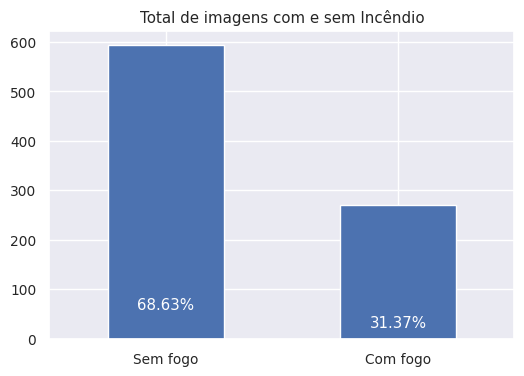

In [ ]:
# Gráfico de barras com a distribuição da variável class1 usada como target

valores = df['class1'].value_counts(normalize=True) * 100
fig, ax = plt.subplots(figsize = (6, 4))
fire_count = df['class1'].value_counts().plot.bar(title='Total de imagens com e sem Incêndio')
print((df['class1']).value_counts())

# Adicionar o label no topo de cada barra
for i, valor in enumerate(valores):
    ax.text(i, valor, f'{valor:.2f}%', ha='center', va='center', c='white')

#plt.subplots_adjust(top=0.9)
plt.xticks(rotation=360)
plt.show()

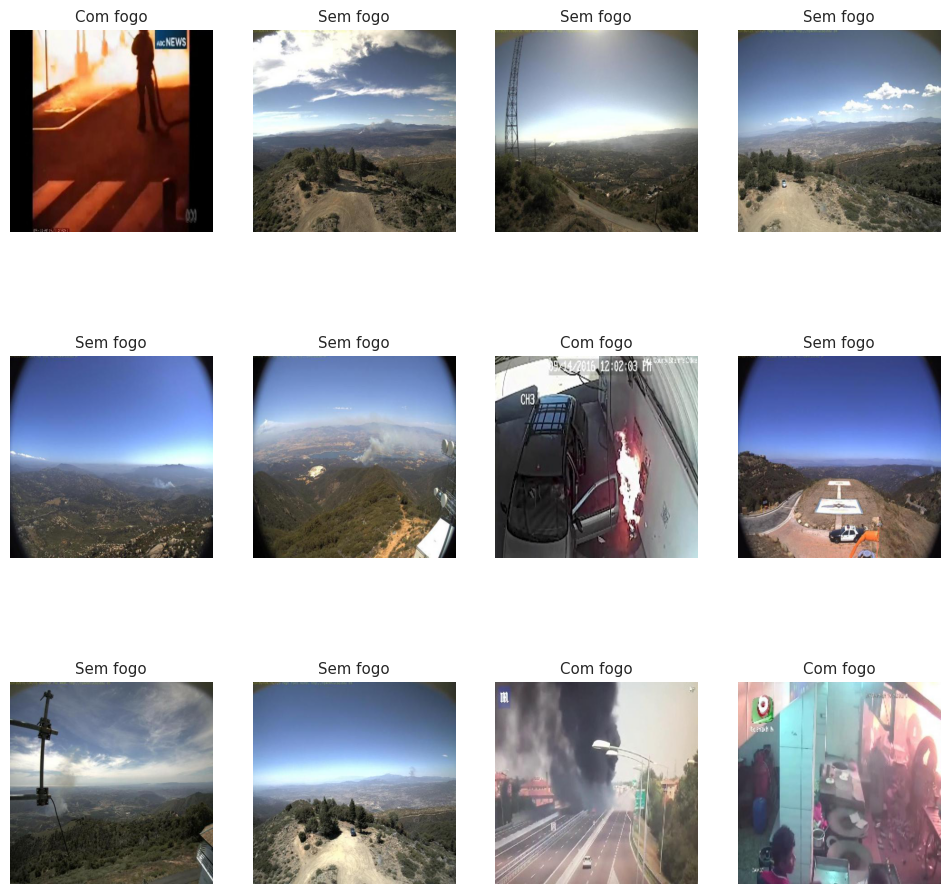

In [ ]:
# Apreentando uma amostra de 12 imagens

fig = plt.gcf()
fig.set_size_inches(3*4, 3*4)

# Visualizando apenas 12 imagens
for i in range(12):

    sample = np.random.choice(images)
    img_path = r+sample
    sp = plt.subplot(3, 4, i + 1)
    sp.axis('Off')
    img = mpimg.imread(img_path)
    plt.imshow(img)
    plt.title(sample[:3])

    if sample[:3] == 'img':
      plt.title('Com fogo')
    if sample[:3] == 'ck0':
      plt.title('Sem fogo')
    else:
      plt.title('Com fogo')

plt.show()

Divisão dos dados em treino e teste: 30% das imagens para teste e 70% para treinamento do modelo de deep learning. Importante lembrar que os conjuntos devem ser disjuntos, ou seja, não devem poussir nenhum elemento em comum.

In [ ]:
# Divisão dos dados entre treino e teste

train, test = train_test_split(df[['images' , 'class1']] ,test_size=0.3 ,random_state=42 , shuffle=True)

Sem fogo    421
Com fogo    183
Name: class1, dtype: int64


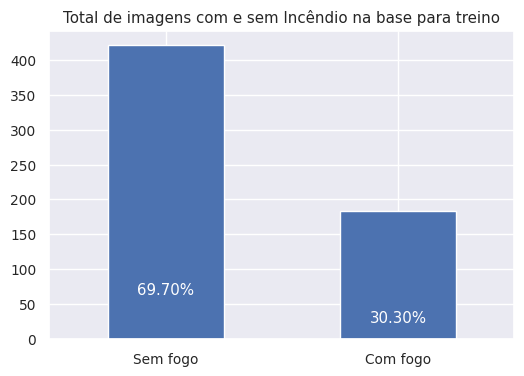

In [ ]:
# Gráfico de barras com a distribuição da variável class1 usada como target base treino

valores = train['class1'].value_counts(normalize=True) * 100
fig, ax = plt.subplots(figsize = (6, 4))
fire_count = train['class1'].value_counts().plot.bar(title='Total de imagens com e sem Incêndio na base para treino')
print((train['class1']).value_counts())

# Adicionar o label no topo de cada barra
for i, valor in enumerate(valores):
    ax.text(i, valor, f'{valor:.2f}%', ha='center', va='center', c='white')

#plt.subplots_adjust(top=0.9)
plt.xticks(rotation=360)
plt.show()

Sem fogo    172
Com fogo     88
Name: class1, dtype: int64


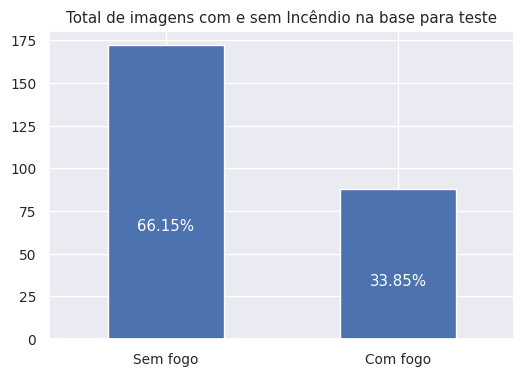

In [ ]:
# Gráfico de barras com a distribuição da variável class1 usada como target base teste

valores = test['class1'].value_counts(normalize=True) * 100
fig, ax = plt.subplots(figsize = (6, 4))
fire_count = test['class1'].value_counts().plot.bar(title='Total de imagens com e sem Incêndio na base para teste')
print((test['class1']).value_counts())

# Adicionar o label no topo de cada barra
for i, valor in enumerate(valores):
    ax.text(i, valor, f'{valor:.2f}%', ha='center', va='center', c='white')

#plt.subplots_adjust(top=0.9)
plt.xticks(rotation=360)
plt.show()

In [ ]:
# Visualizando a divisão dos dados treino e teste

print("##### Train: #####")
print(train)
print("##### Test: #####")
print(test)

##### Train: #####
                                                images    class1
850  img_438_jpg.rf.7c63d605fa4794d8fa2ce6c5e7756f4...  Com fogo
193  img_106_jpg.rf.0e5aec583bf1ee4e56a8e0ef146eaa5...  Sem fogo
280  ck0qdhfh1uks20848pclbrty6_jpeg_jpg.rf.258ae4a7...  Sem fogo
468  ck0u13xaxuv4k07010miwxisb_jpeg_jpg.rf.ad39e0ac...  Sem fogo
486  ck0t1zwemkseu08636i7fpksi_jpeg_jpg.rf.af596fa4...  Sem fogo
..                                                 ...       ...
106  ck0k99e6p79go0944lmxivkmv_jpeg_jpg.rf.f048b8d8...  Sem fogo
270  img_646_jpg.rf.1f666f053ca5b1c7c6bbb7fe08df29c...  Com fogo
860  ck0keprw9ke1d08483vmle7ed_jpeg_jpg.rf.7a4625db...  Sem fogo
435  ck0qbnoibg4ip0838na1tnqe8_jpeg_jpg.rf.a28231b9...  Sem fogo
102  ck0l939lbnftj0a46atyx4hh4_jpeg_jpg.rf.ef9cc98a...  Sem fogo

[604 rows x 2 columns]
##### Test: #####
                                                images    class1
198  img_449_jpg.rf.0fb72a6884a61dfdaa7622ad422f601...  Com fogo
720  img_388_jpg.rf.532a1d8de

##4.1 - Preparação dos dados

In [ ]:
train_datagen=ImageDataGenerator(validation_split=0.2, #include validation split
                                 rescale = 1.0/255,
                                 rotation_range=40,
                                 shear_range=0.2,
                                 zoom_range=0.2,
                                 horizontal_flip=True,
                                 fill_mode='nearest')

test_datagen=ImageDataGenerator(rescale=1./255)


train_generator=train_datagen.flow_from_dataframe(
    train ,r,
    target_size=(150,150),
    batch_size=100,
    class_mode='binary',
    x_col='images',
    y_col='class1',
    subset='training' #training set
    )

val_generator=train_datagen.flow_from_dataframe(
    train ,r,
    target_size=(150,150),
    batch_size=100,
    class_mode='binary',
    x_col='images',
    y_col='class1',
    subset='validation' #validation set
    )

test_generator=test_datagen.flow_from_dataframe(
    test ,r,
    target_size=(150,150),
    batch_size=100,
    class_mode='binary',
    x_col='images',
    y_col='class1')

Found 484 validated image filenames belonging to 2 classes.
Found 120 validated image filenames belonging to 2 classes.
Found 260 validated image filenames belonging to 2 classes.


Found 1 validated image filenames belonging to 1 classes.


<Figure size 1200x1200 with 0 Axes>

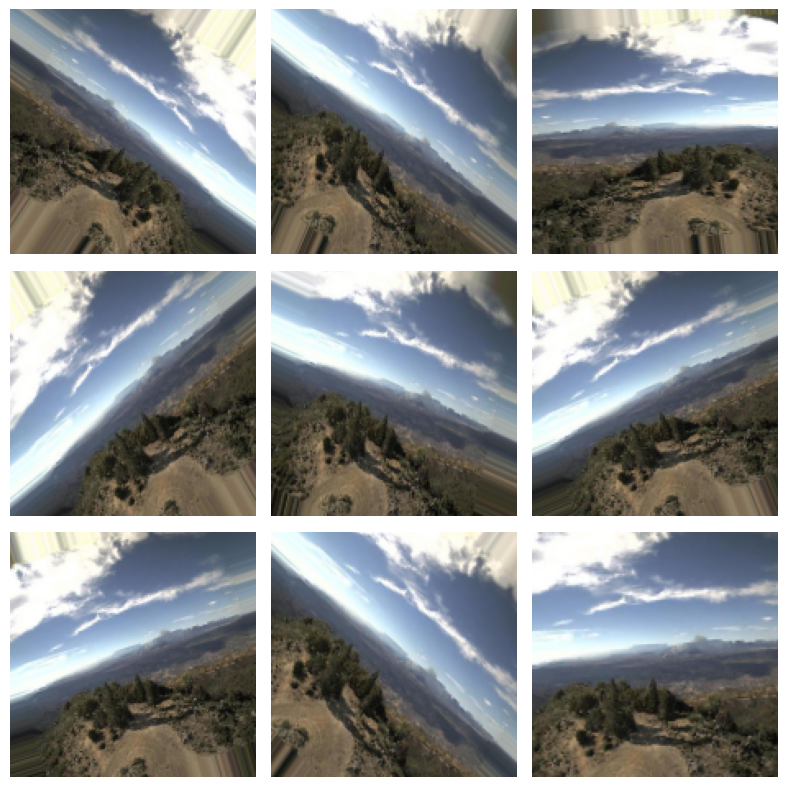

In [ ]:
fig = plt.gcf()
fig.set_size_inches(3*4, 3*4)

# Pegando um registro do dataframe
sample = df.sample(n=1)

# Neste caso o tipo de classe é categorico, pois temos um exemplo com apenas uma classe
sample_generator = train_datagen.flow_from_dataframe(
    sample,
    r,
    x_col='images',
    y_col='class1',
    target_size=(150,150),
    class_mode='categorical'
)

plt.figure(figsize=(8, 8))
for i in range(9):
    plt.subplot(3, 3, i+1)
    for x_batch, y_batch in sample_generator:
        image = x_batch[0]
        plt.imshow(image)
        plt.axis('Off')
        break
plt.tight_layout()
plt.show()

# ***5. Configuração de um modelo de deep learning usando uma rede neural convolucional (CNN) simples com a biblioteca Keras***

##5.1 - Definição da arquitetura do modelo

In [ ]:
model=models.Sequential()
model.add(layers.Conv2D(32 ,(3,3) , activation='relu' , input_shape=(150,150,3 ) ) )
model.add(layers.MaxPooling2D( (2,2)))

model.add(layers.Conv2D(64 , (3,3) , activation='relu'))
model.add(layers.MaxPooling2D( (2,2)))

model.add(layers.Conv2D(128 , (3,3) , activation='relu'))
model.add(layers.MaxPooling2D( (2,2)))

model.add(layers.Conv2D(128 , (3,3) , activation='relu'))
model.add(layers.MaxPooling2D( (2,2)))

In [ ]:
model.add(layers.Flatten() )
model.add(layers.Dropout(0.25))
model.add(layers.Dense( 512 ,activation='relu' ))
model.add(layers.Dropout(0.25))
model.add(layers.Dense( 1 , activation='sigmoid' ) )

In [ ]:
# Resumo da arquitetura do modelo

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 74, 74, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 72, 72, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 36, 36, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 34, 34, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 17, 17, 128)      0

# ***6. Treinamento do modelo de deep learning***

##6.1 - Compilação do modelo Keras com as configurações do treinamento

In [ ]:
model.compile(optimizer='adam', loss='binary_crossentropy' , metrics=['accuracy'])

In [ ]:
history=model.fit_generator(train_generator,
                            epochs=15,
                            validation_data=val_generator)

<ipython-input-28-c7fb0de44f60>:1: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history=model.fit_generator(train_generator,


Epoch 1/15
5/5 [==============================] - 19s 1s/step - loss: 0.8245 - accuracy: 0.5950 - val_loss: 0.6620 - val_accuracy: 0.7833
Epoch 2/15
5/5 [==============================] - 7s 1s/step - loss: 0.5963 - accuracy: 0.7810 - val_loss: 0.4589 - val_accuracy: 0.7667
Epoch 3/15
5/5 [==============================] - 5s 1s/step - loss: 0.5083 - accuracy: 0.7479 - val_loss: 0.6268 - val_accuracy: 0.7000
Epoch 4/15
5/5 [==============================] - 7s 1s/step - loss: 0.4388 - accuracy: 0.7769 - val_loss: 0.4205 - val_accuracy: 0.7833
Epoch 5/15
5/5 [==============================] - 5s 1s/step - loss: 0.3492 - accuracy: 0.8492 - val_loss: 0.3717 - val_accuracy: 0.8333
Epoch 6/15
5/5 [==============================] - 7s 2s/step - loss: 0.2919 - accuracy: 0.8698 - val_loss: 0.4207 - val_accuracy: 0.8083
Epoch 7/15
5/5 [==============================] - 6s 1s/step - loss: 0.2807 - accuracy: 0.8884 - val_loss: 0.3369 - val_accuracy: 0.8250
Epoch 8/15
5/5 [========================

# ***7. Execução do modelo treinado em um subconjunto das imagems de teste***

4/4 [==============================] - 1s 46ms/step


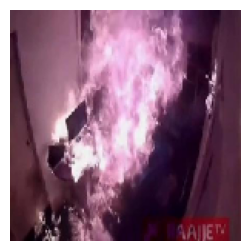

Label:  Com fogo
Previsão:  Sem fogo
Probabilidade:  0.9374129


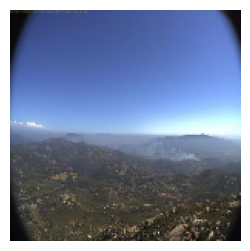

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99985886


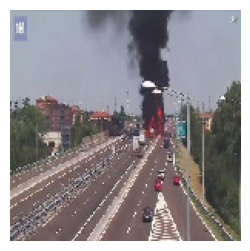

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.8491377


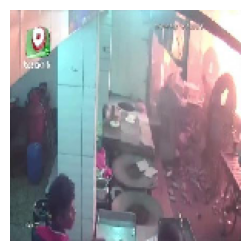

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.39468455


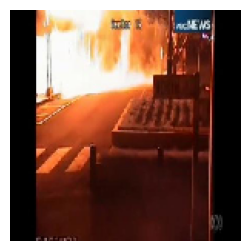

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.070389636


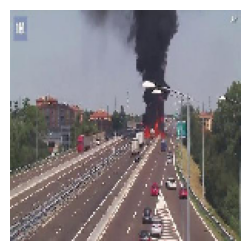

Label:  Com fogo
Previsão:  Sem fogo
Probabilidade:  0.8664241


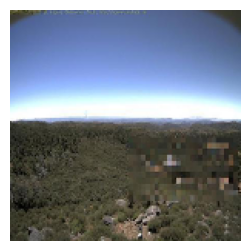

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99935216


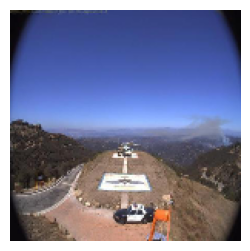

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9998698


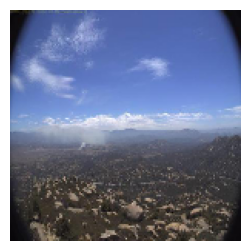

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9998661


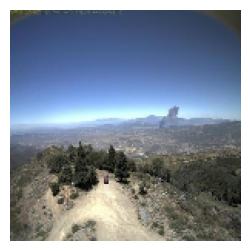

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9999336


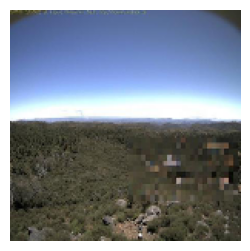

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99939203


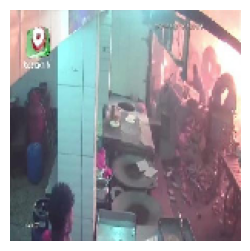

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.30458814


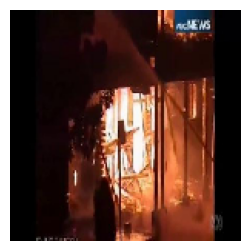

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.010889187


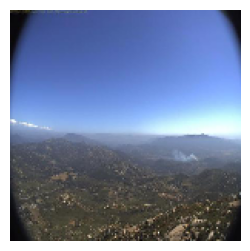

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99988997


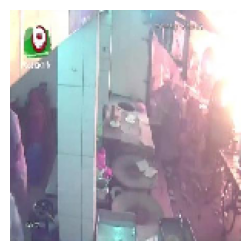

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.0726533


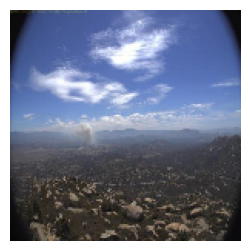

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9996705


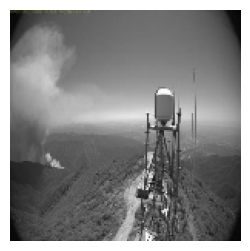

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.98839474


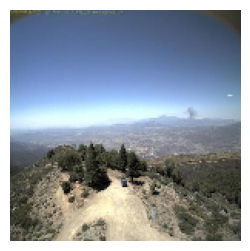

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99996567


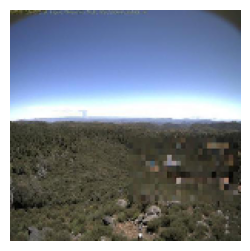

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9993781


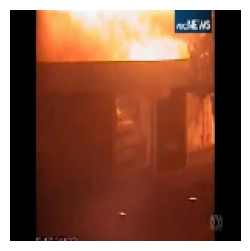

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.045198057


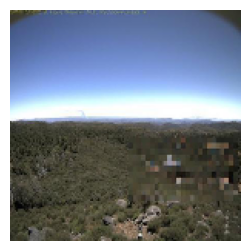

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9993569


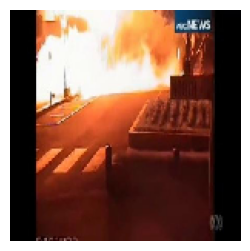

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.08504237


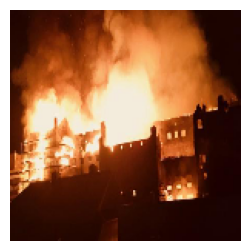

Label:  Com fogo
Previsão:  Sem fogo
Probabilidade:  0.81687444


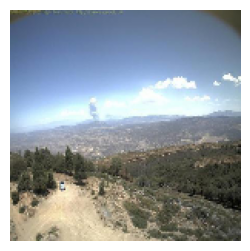

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9998566


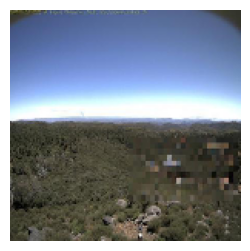

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99937624


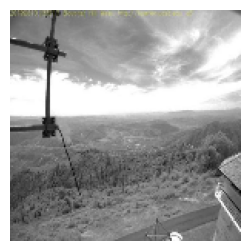

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.98944527


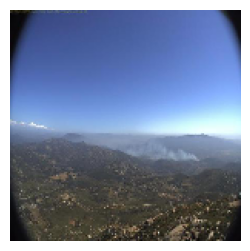

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99985397


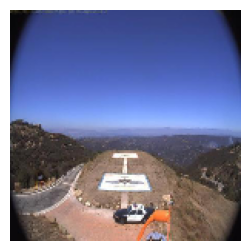

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99989855


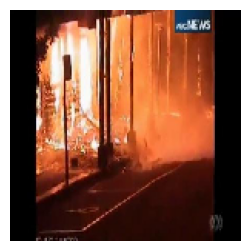

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.0345791


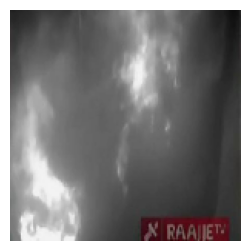

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.4061383


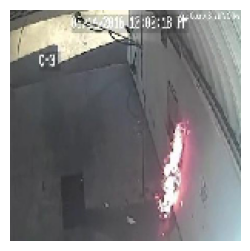

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.05131429


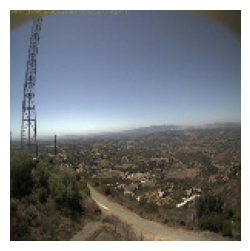

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.999731


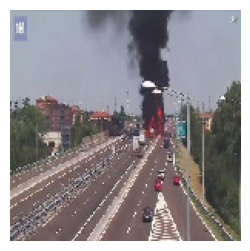

Label:  Com fogo
Previsão:  Sem fogo
Probabilidade:  0.8491377


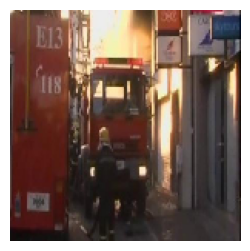

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.19505046


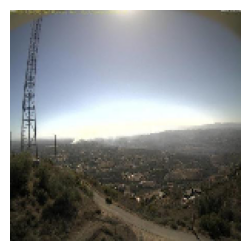

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9998429


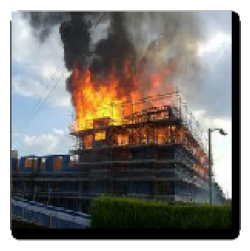

Label:  Com fogo
Previsão:  Sem fogo
Probabilidade:  0.60939974


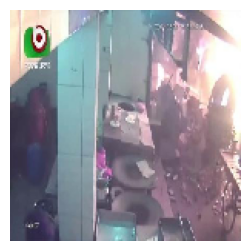

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.07882673


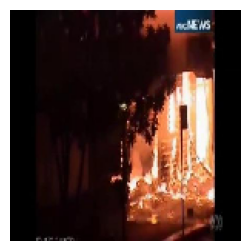

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.00696556


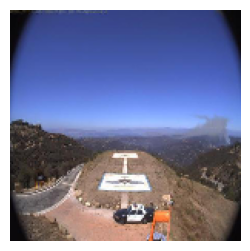

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9999083


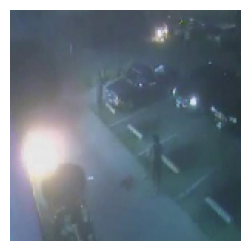

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.2558108


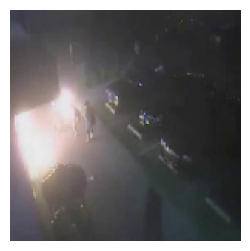

Label:  Com fogo
Previsão:  Sem fogo
Probabilidade:  0.50613767


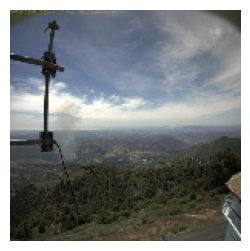

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9968838


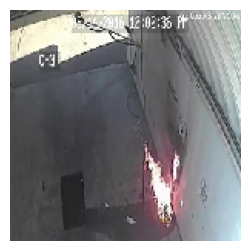

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.07271869


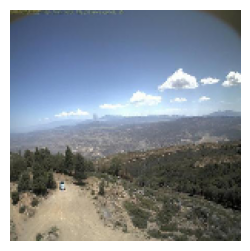

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9998103


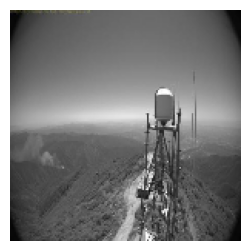

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9892721


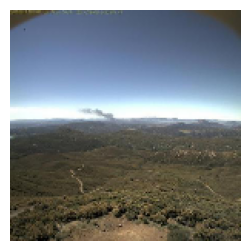

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9994796


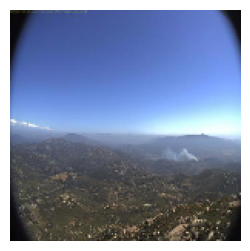

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9998933


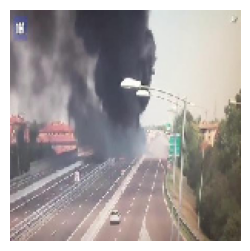

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.8633521


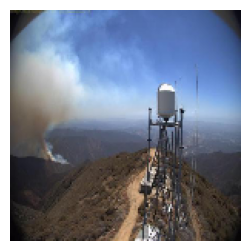

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9993218


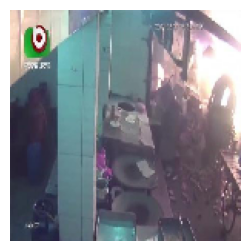

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.08225996


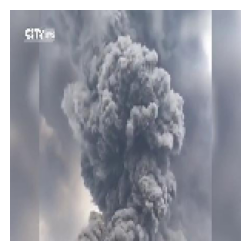

Label:  Sem fogo
Previsão:  Com fogo
Probabilidade:  0.07877974


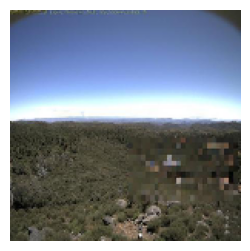

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9993699


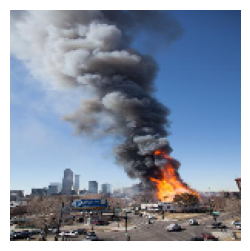

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.90173954


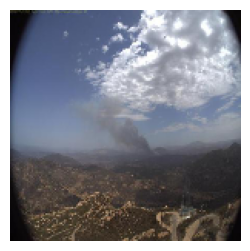

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9939207


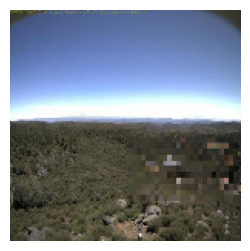

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9993783


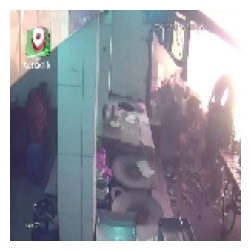

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.09700546


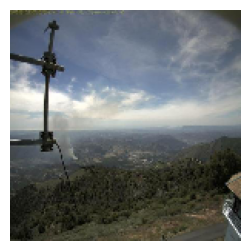

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99642205


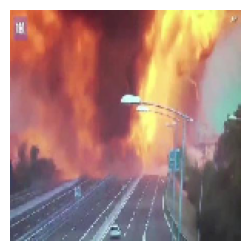

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.08999995


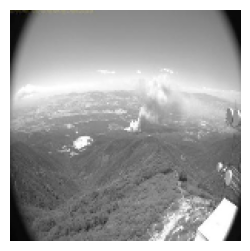

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.97574097


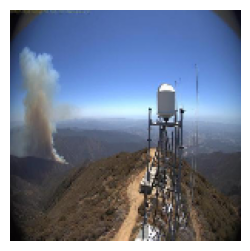

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99972576


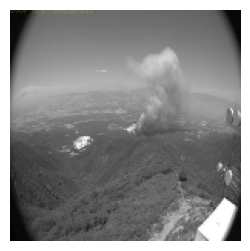

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.90139616


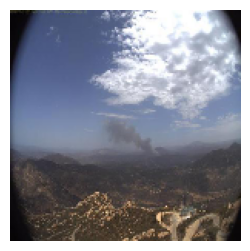

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99748814


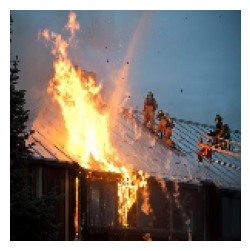

Label:  Com fogo
Previsão:  Sem fogo
Probabilidade:  0.86182046


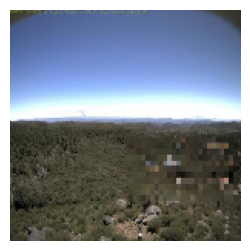

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99937016


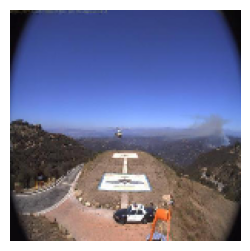

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99988794


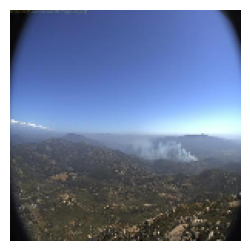

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9998597


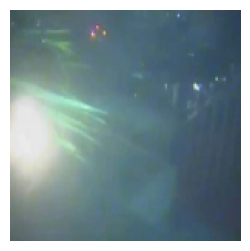

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.27603048


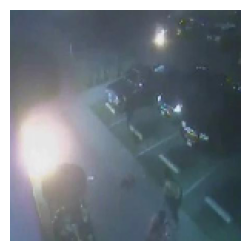

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.3363773


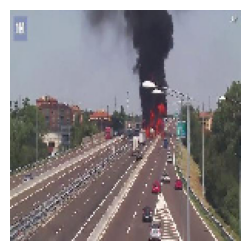

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.84367114


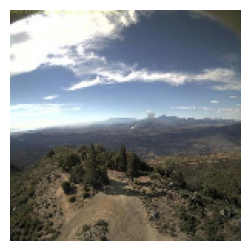

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9994993


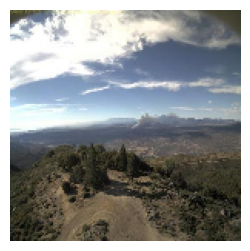

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9991235


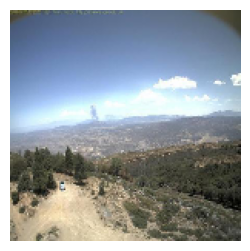

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99986553


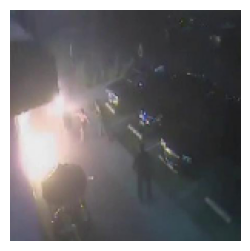

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.4345911


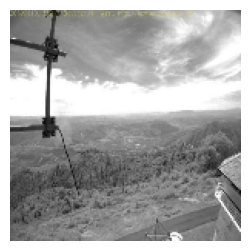

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9899137


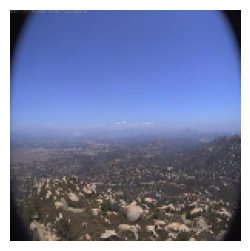

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99993074


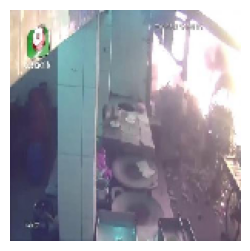

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.10290204


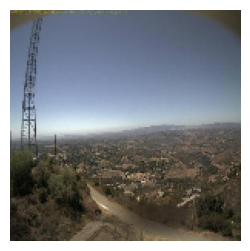

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9996001


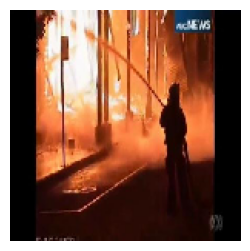

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.10145176


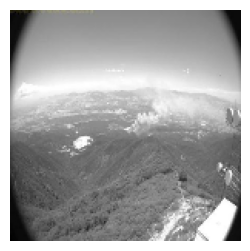

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.97979695


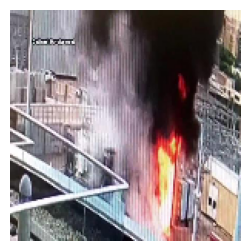

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.4535082


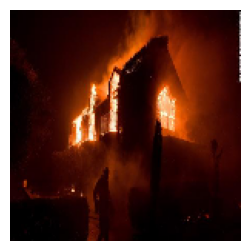

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.058428064


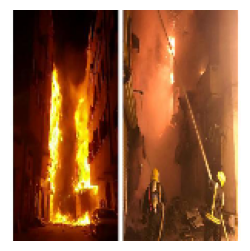

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.045715198


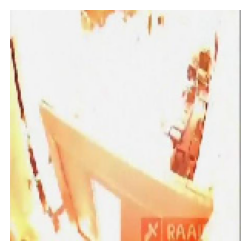

Label:  Com fogo
Previsão:  Sem fogo
Probabilidade:  0.9907899


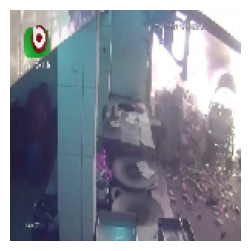

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.11936025


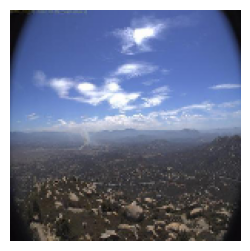

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99979395


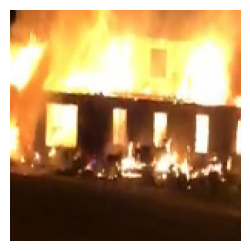

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.44057927


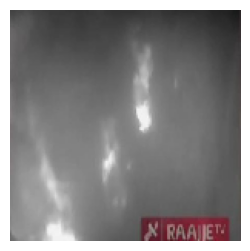

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.3591919


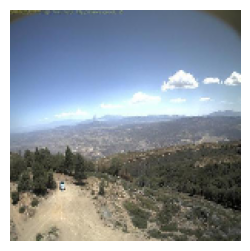

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9998641


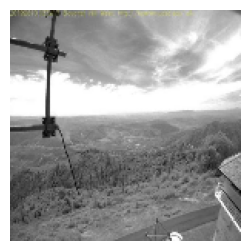

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9897942


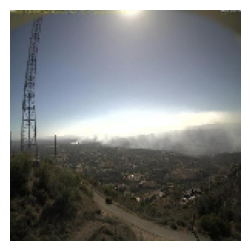

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9996953


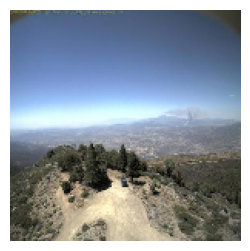

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9999615


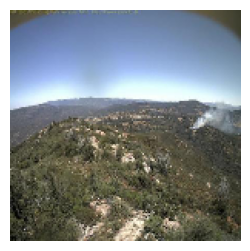

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9838981


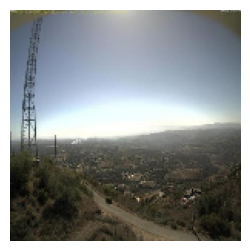

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99985576


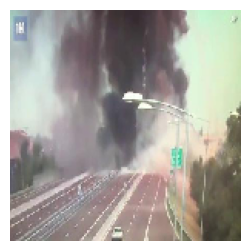

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.6613696


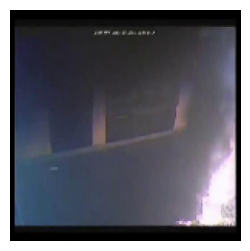

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.011806987


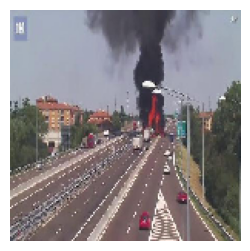

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.8382756


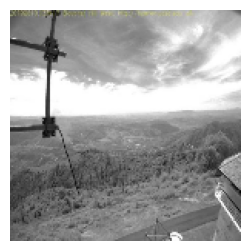

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9900718


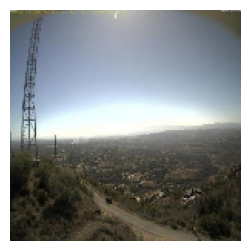

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9998597


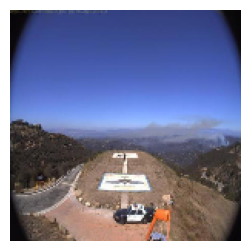

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99988675


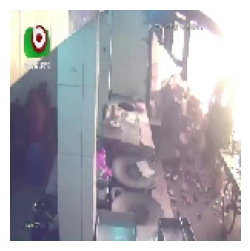

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.059404194


In [ ]:
count = 0
y_pred = list()
y_true = list()
class_names = ['Com fogo', 'Sem fogo']

# Loop do data generator de teste que contem as imagens
for batch in test_generator:

    count+=1

    # Condição de saída do loop. Só executaremos o modelo em algumas imagens
    if count == 2:
        break

    else:

        # Pegando a imagem e o label
        images = batch[0]
        labels = batch[1]

        # Previsão
        predictions = model.predict(images)

        # Visualização da imagem
        for i in range(len(images)):

            image = images[i]
            label = labels[i]
            prediction = predictions[i]

            # Converte o array de previsão para visualizar a classe e a probabilidade
            predicted_class = np.argmax(prediction)
            probability = prediction[predicted_class]
            label = class_names[int(label)]
            y_true.append(label)

            # Faz o DE-PARA da probabilidade com o tipo de classe da previsão
            class_name = 'Sem fogo' if prediction >= 0.5 else 'Com fogo'
            y_pred.append(class_name)

            # Configura a saída das imagens que serão visualizadas
            plt.figure(figsize=(3, 3))
            plt.imshow(images[i])
            plt.axis('Off')
            plt.show()

            # Imprime os resultados da classificação das images
            print("Label: ", label)
            print("Previsão: ", class_name)
            print("Probabilidade: ", probability)

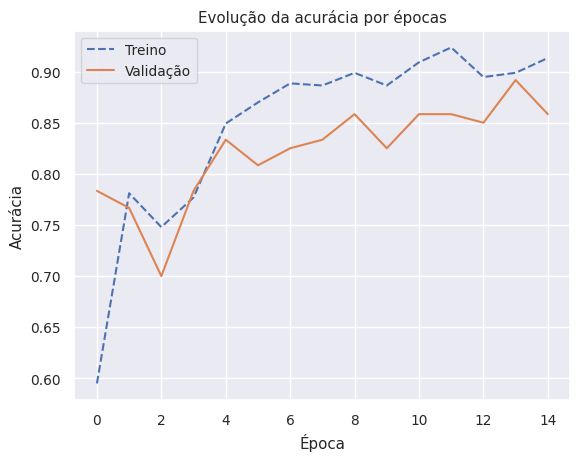

In [ ]:
# livro jornada python pag 493
plt.xlabel('Época')
plt.ylabel('Acurácia')
plt.plot(history.history['accuracy'], '--')
plt.plot(history.history['val_accuracy'])
plt.title("Evolução da acurácia por épocas")
plt.legend(['Treino', 'Validação'])
plt.show();

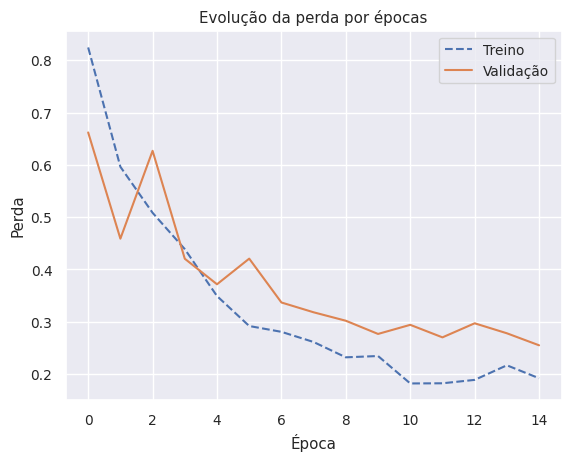

In [ ]:
# livro jornada python pag 493
plt.xlabel('Época')
plt.ylabel('Perda')
plt.plot(history.history['loss'], '--')
plt.plot(history.history['val_loss'])
plt.title("Evolução da perda por épocas")
plt.legend(['Treino', 'Validação'])
plt.show();

# ***8. Avaliação do modelo de deep learning***

In [ ]:
loss, accuracy = model.evaluate_generator(test_generator)
print("Test: accuracy = %f  ;  loss = %f " % (accuracy, loss))

<ipython-input-32-78954c843b8c>:1: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  loss, accuracy = model.evaluate_generator(test_generator)


Test: accuracy = 0.900000  ;  loss = 0.239416 


In [ ]:
accuracy = skm.accuracy_score(y_true, y_pred)
precision = skm.precision_score(y_true, y_pred, average='weighted')
recall = skm.recall_score(y_true, y_pred, average='weighted')
f1score = skm.f1_score(y_true, y_pred, average='weighted')

print("Accuracy: ", accuracy)
print("Precision: ", precision)
print("Recall: ", recall)
print("F1 Score: ", f1score)

Accuracy:  0.91
Precision:  0.9160477941176469
Recall:  0.91
F1 Score:  0.9080052407468063


Confusion matrix, without normalization
[[31  8]
 [ 1 60]]


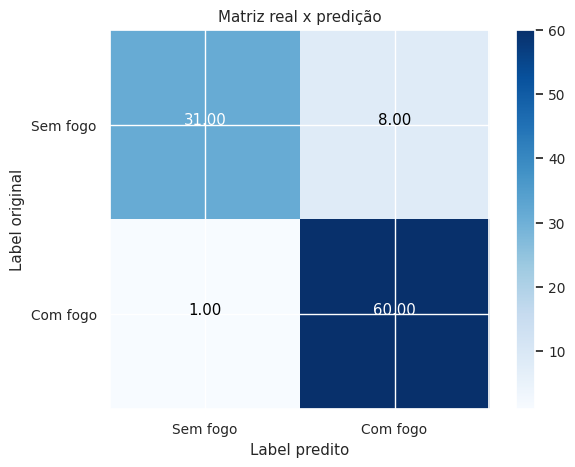

In [ ]:
"""import matplotlib.pyplot as plt
import numpy as np
import itertools"""

def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion Matrix', cmap=plt.cm.Blues):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()

    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=360)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, "{:.2f}".format(cm[i, j]),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('Label original')
    plt.xlabel('Label predito')
    plt.tight_layout()

# Exemplo de uso
cnf_matrix = confusion_matrix(y_true, y_pred, labels=class_names)
np.set_printoptions(precision=2)

plt.figure()
plot_confusion_matrix(cnf_matrix,
                      classes=['Sem fogo',
                               'Com fogo'],
                      normalize=False,
                      title='Matriz real x predição')

plt.show()


# ***9. Exportação do modelo de deep learning para posterior uso***

In [ ]:
# obtendo a data e hora atual
now = datetime.now()

# Definição do formato
format = '%Y-%m-%dT%H%M'

# Converter a data e hora em uma string com o formato especificado
formatted_datetime = now.strftime(format)

path_model = 'datasets/dogs_vs_cats/trained_models'

name_model = 'trained_model_' + formatted_datetime + '.h5'

# salvando o modelo
model.save("%s/%s" % (path_model, name_model))
print("Modelo salvo com o nome: ", name_model)

Modelo salvo com o nome:  trained_model_2023-07-09T2144.h5


# ***10. Teste do modelo exportado***

In [ ]:
loaded_model = keras.models.load_model("%s/%s" % (path_model, name_model))
print("Modelo %s carregado com sucesso" % (name_model))

Modelo trained_model_2023-07-09T2144.h5 carregado com sucesso


2/2 [==============================] - 0s 241ms/step


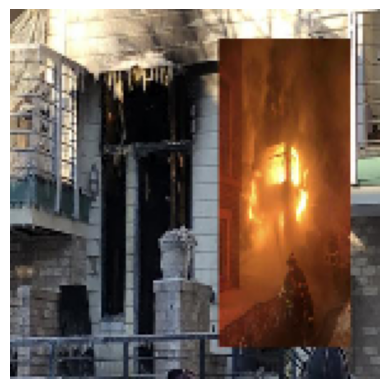

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.05160921


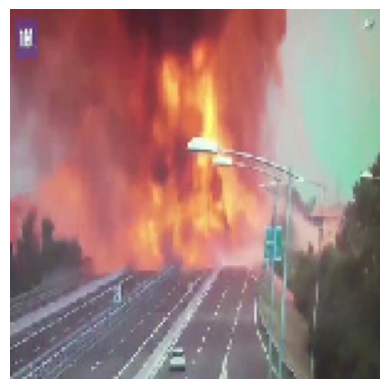

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.24018563


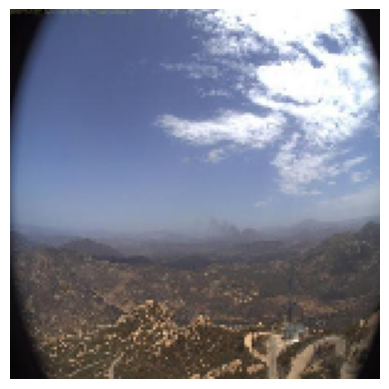

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9991504


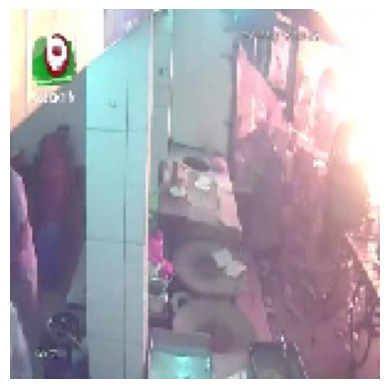

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.0726533


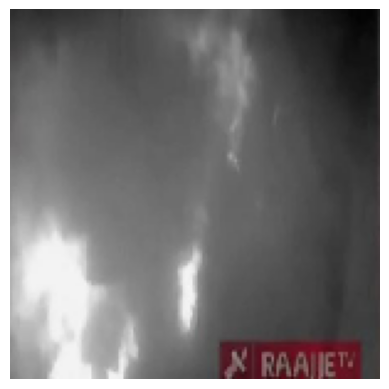

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.09518574


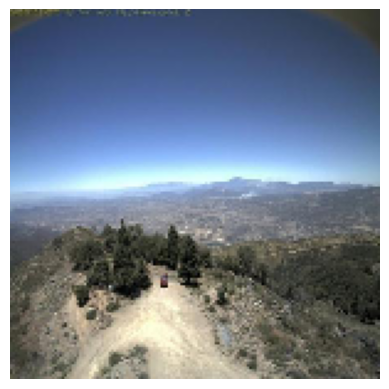

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.999938


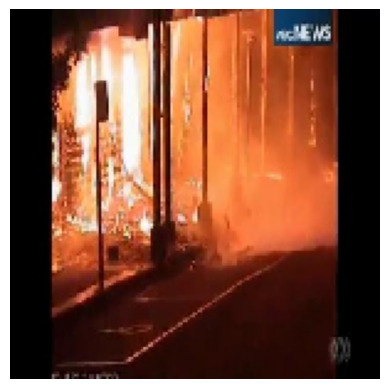

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.0345791


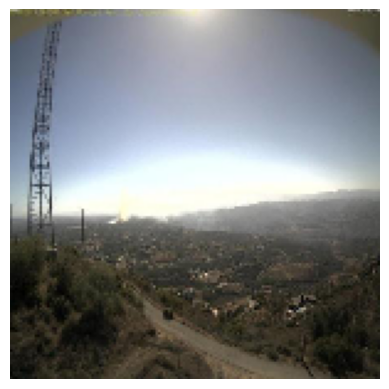

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9998462


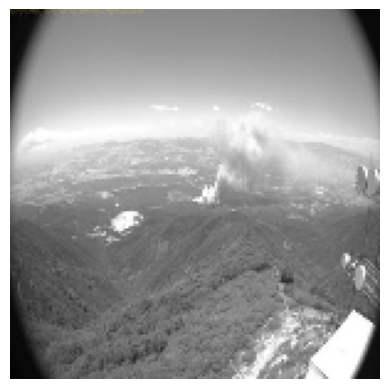

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.97574097


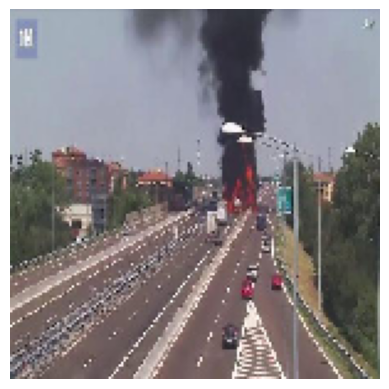

Label:  Com fogo
Previsão:  Sem fogo
Probabilidade:  0.8491377


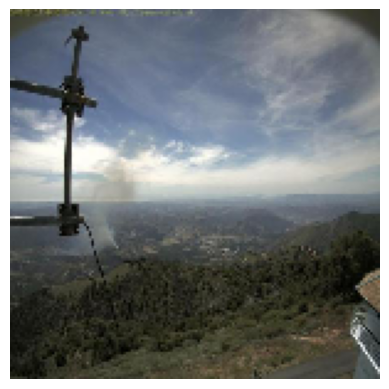

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99629897


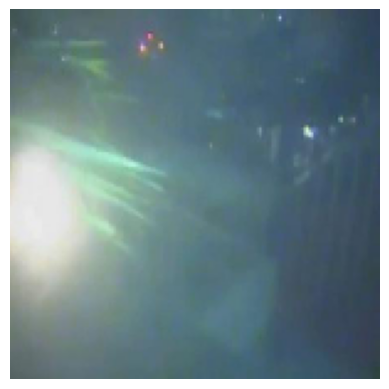

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.27603048


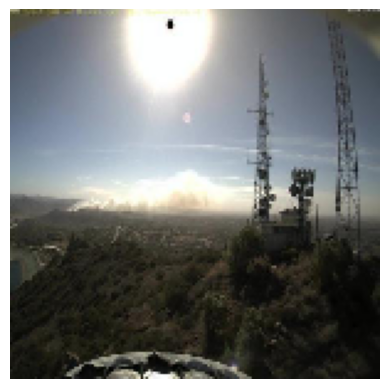

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.997997


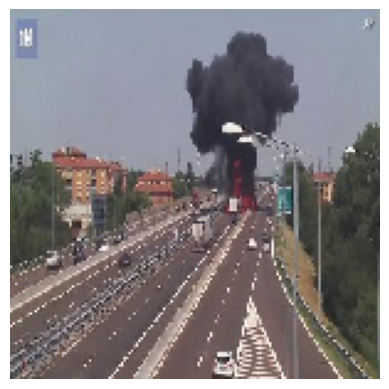

Label:  Com fogo
Previsão:  Sem fogo
Probabilidade:  0.78639483


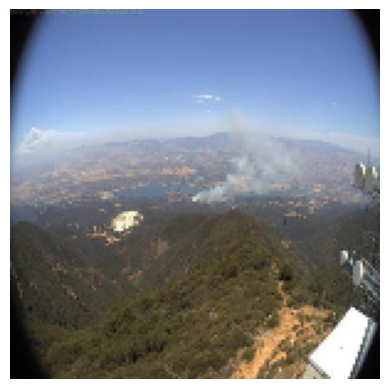

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99343675


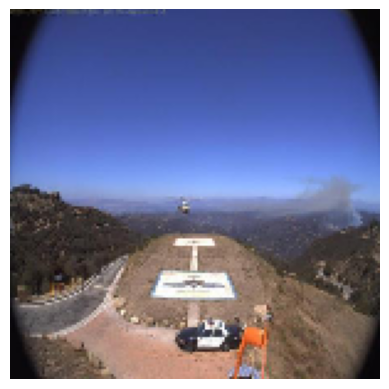

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99988794


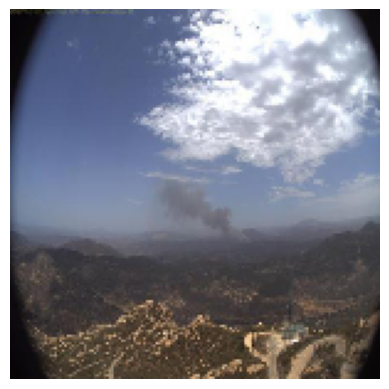

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9974567


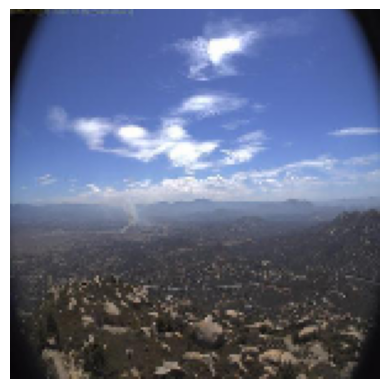

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99979395


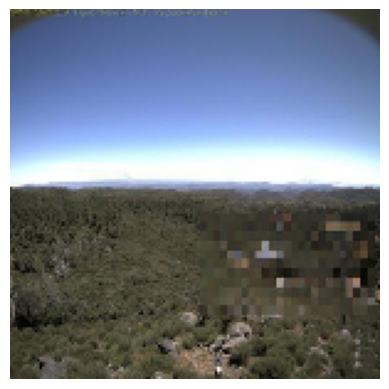

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9993783


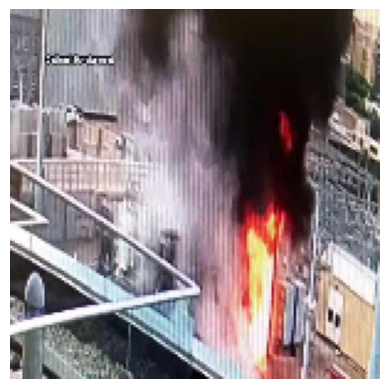

Label:  Sem fogo
Previsão:  Com fogo
Probabilidade:  0.4535082


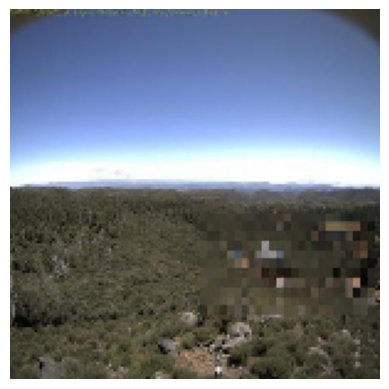

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99941444


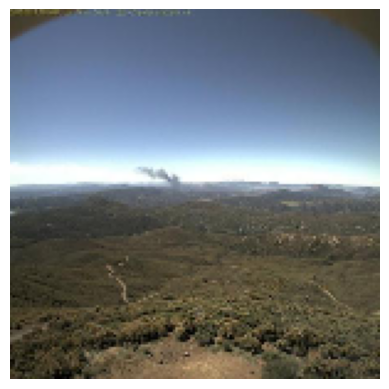

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9994684


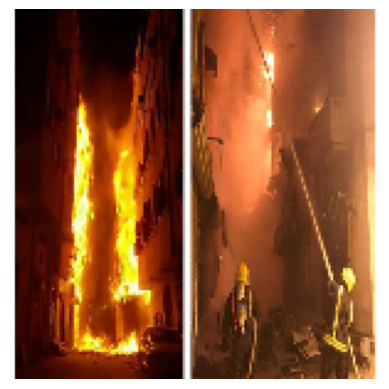

Label:  Sem fogo
Previsão:  Com fogo
Probabilidade:  0.045715198


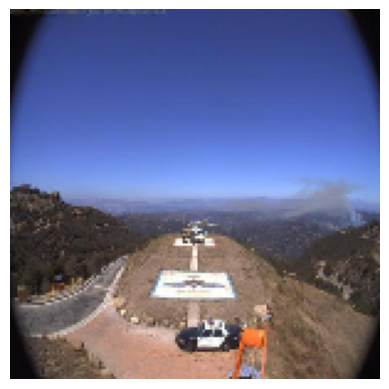

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9998698


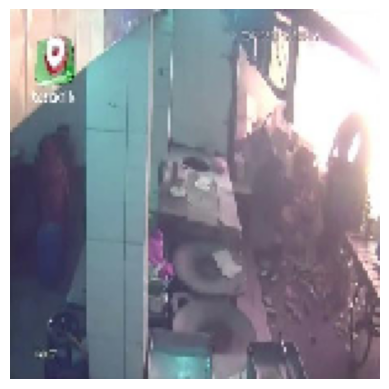

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.09700546


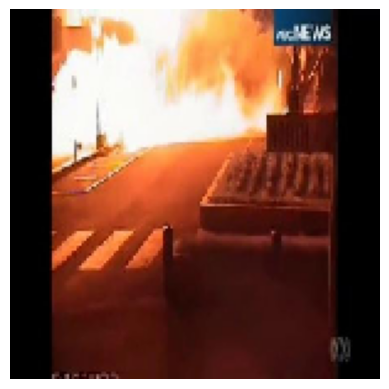

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.08504237


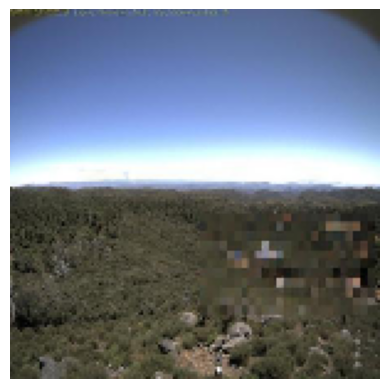

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9993699


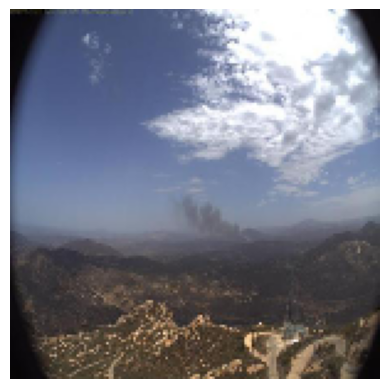

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99825007


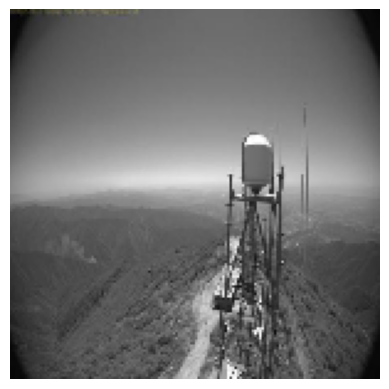

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9895699


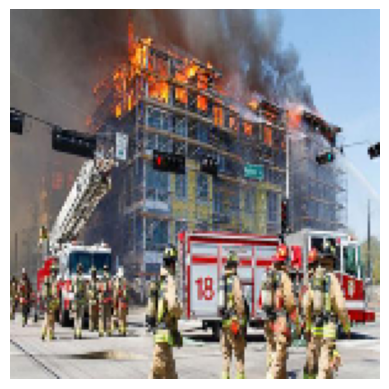

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.76147646


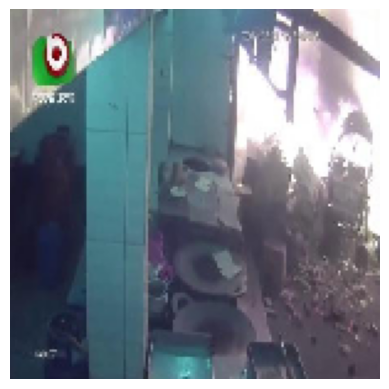

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.14967792


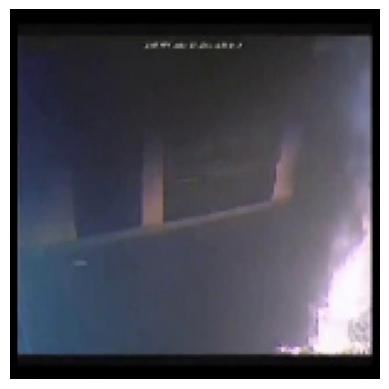

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.011806987


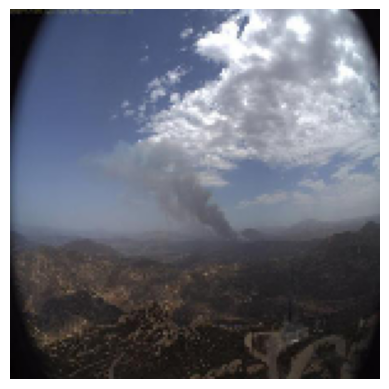

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99031305


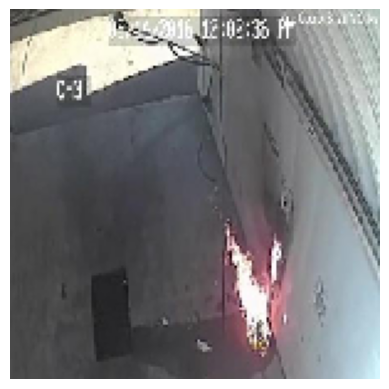

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.07271872


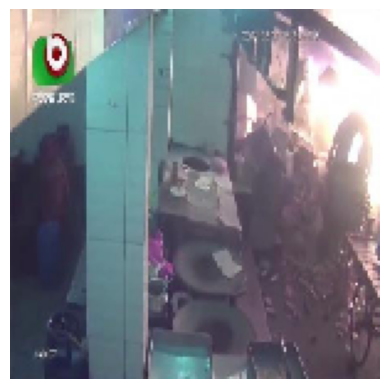

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.08225999


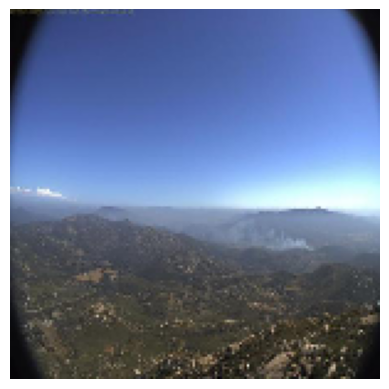

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99985886


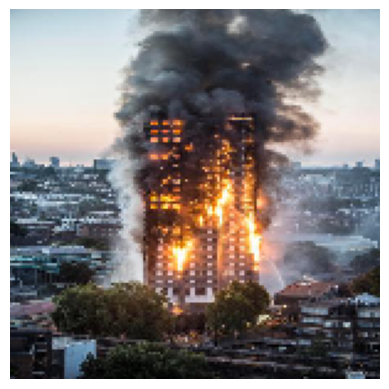

Label:  Com fogo
Previsão:  Sem fogo
Probabilidade:  0.5673179


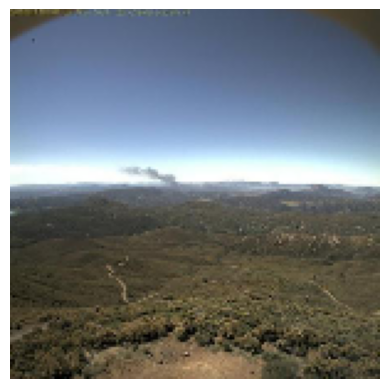

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9994796


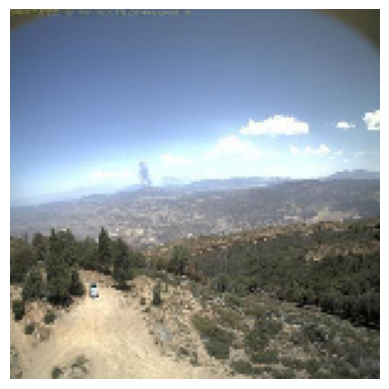

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99986553


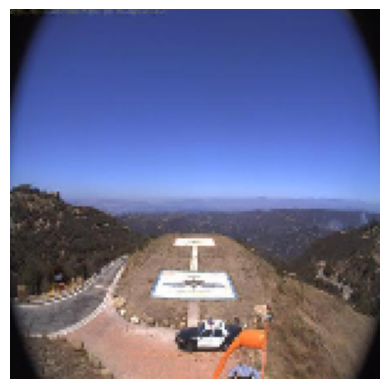

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99989855


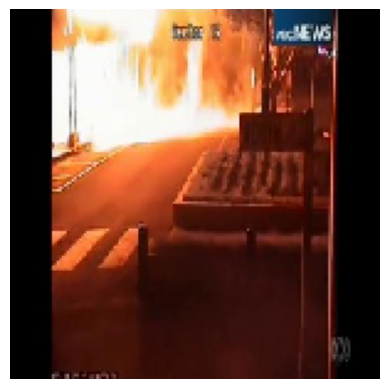

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.07038971


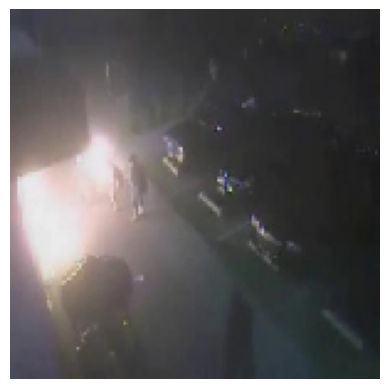

Label:  Com fogo
Previsão:  Sem fogo
Probabilidade:  0.5061376


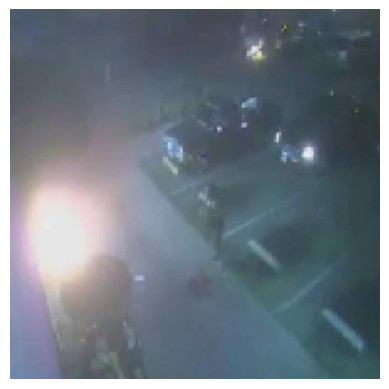

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.24376848


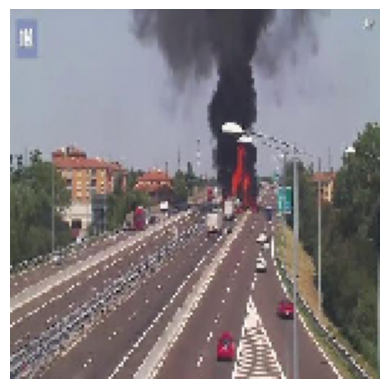

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.8382755


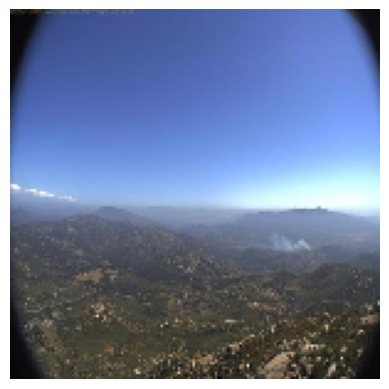

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99988997


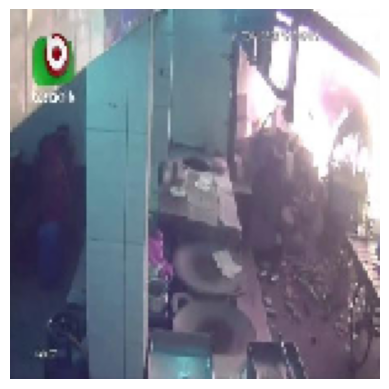

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.082727745


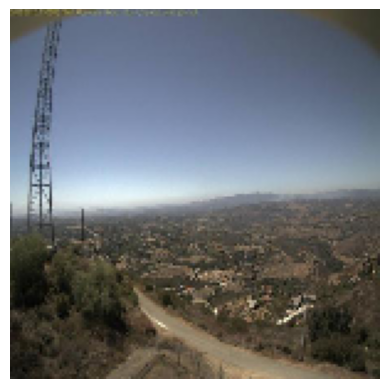

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9997261


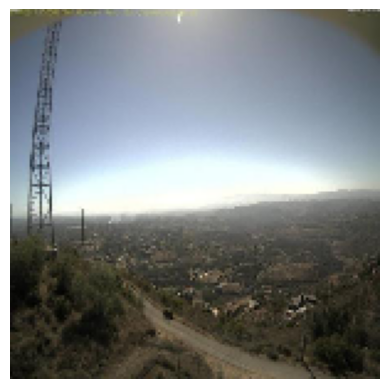

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9998597


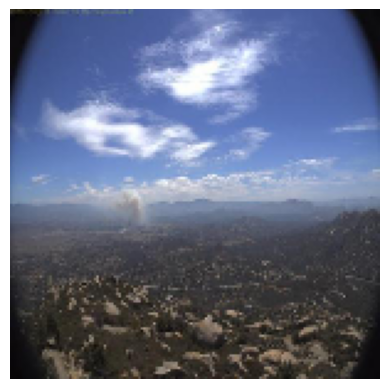

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9996705


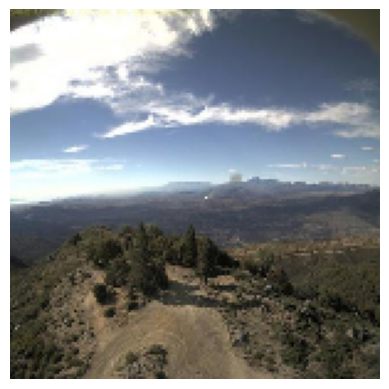

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9994993


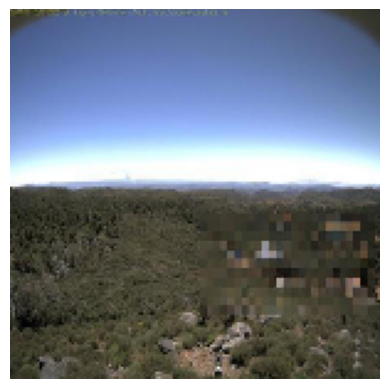

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9993587


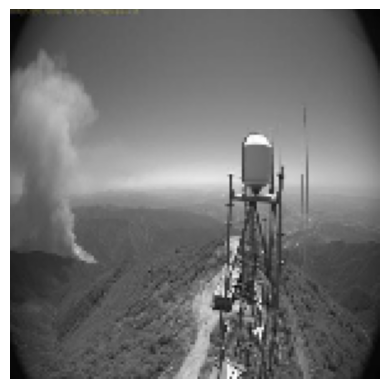

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9879615


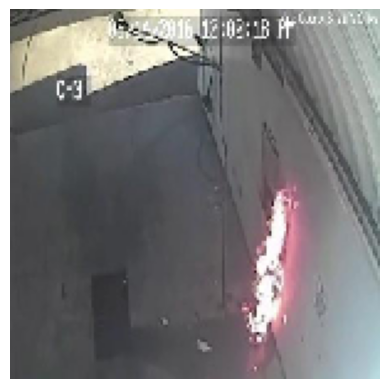

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.051314298


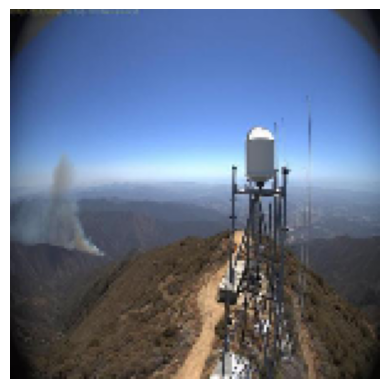

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9997793


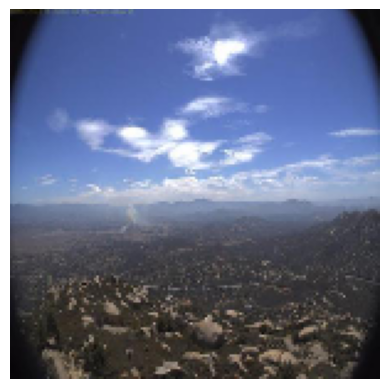

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9997906


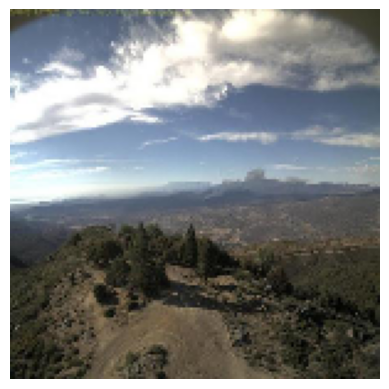

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9987953


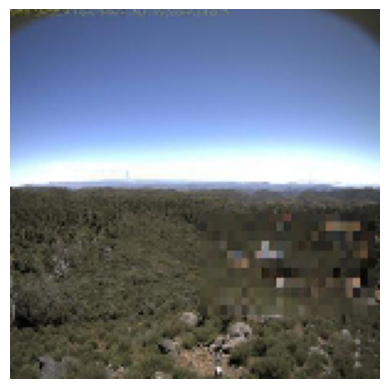

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9993742


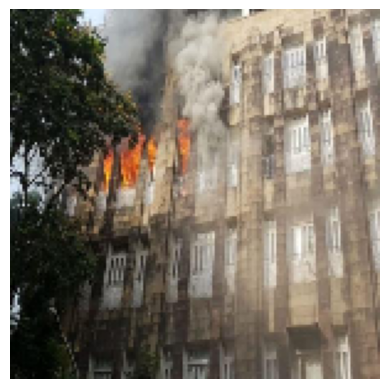

Label:  Com fogo
Previsão:  Com fogo
Probabilidade:  0.08569254


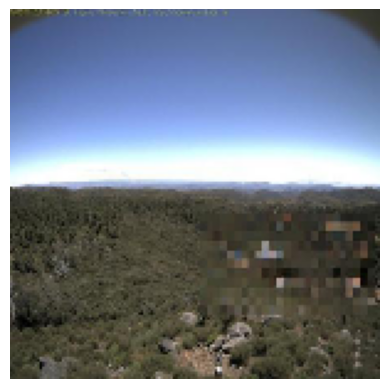

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.99936646


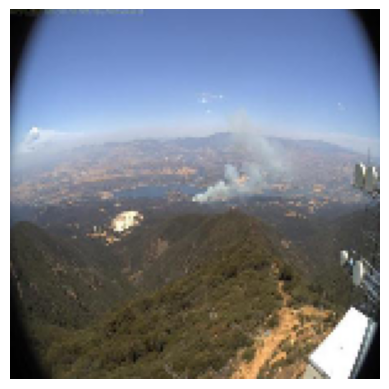

Label:  Sem fogo
Previsão:  Sem fogo
Probabilidade:  0.9931732


In [ ]:
count = 0
y_pred = list()
y_true = list()
class_names = ['Com fogo', 'Sem fogo']

# Loop do data generator de teste que contem as imagens
for batch in test_generator:

    count+=1

    # Condição de saída do loop. Só executaremos o modelo em algumas imagens
    if count == 2:
        break

    else:

        # Pegando a imagem e o label
        images = batch[0]
        labels = batch[1]

        # Previsão
        predictions = loaded_model.predict(images)

        # Visualização da imagem
        for i in range(len(images)):

            image = images[i]
            label = labels[i]
            prediction = predictions[i]

            # Converte o array de previsão para visualizar a classe e a probabilidade
            predicted_class = np.argmax(prediction)
            probability = prediction[predicted_class]
            label = class_names[int(label)]
            y_true.append(label)

            # Faz o DE-PARA da probabilidade com o tipo de classe da previsão
            class_name = 'Sem fogo' if prediction >= 0.5 else 'Com fogo'
            y_pred.append(class_name)

            # Configura a saída das imagens que serão visualizadas
            plt.imshow(images[i])
            plt.axis('Off')
            plt.show()

            # Imprime os resultados da classificação das images
            print("Label: ", label)
            print("Previsão: ", class_name)
            print("Probabilidade: ", probability)